# Disparity Estimation

- ref link: https://learnopencv.com/disparity-estimation-using-deep-learning/



- Conventional video or picture captures the three dimensional world in two dimensions, losing crucial information regarding **DEPTH**.
- Which many applications now demand.
- Popular setup is Stereo Vision
which uses a pair of cameras, finds corresponding points in the two cameras, and estimates the depth based on disparity.
- More recently setup, called Stereo Vision, uses a pair of cameras.
- Finds corresponding points in the two cameras, and estimates the depth based on disparity.
- more recently, deep learning based methods have been used to estimate disparity from a stereo pair of images.

Classical approach to disparity estimation

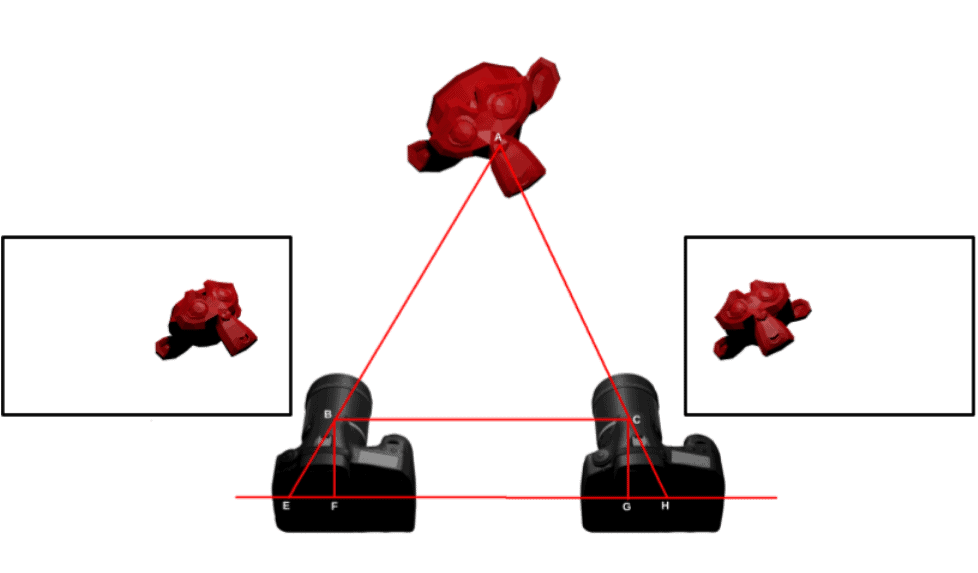

- classical methods to find a disparity map for a pair of rectified stereo images uses the stereo-matching technique.
- This tech, computes the correspondence between the pixels of the left and the right image.
- Using a stereo pair, the disparity map is obtained.


# Stereo camera depth estimation with OpenCV

- How 🤖-robots navigate autonomously, grasp different objects,or avoid collisions while moving?
- Solution: Stereo vision-based depth estimation


Discussion:
- classical methods for stereo matching and for depth perception.


###Requirements:


### Camera calibration using OpenCV

- A camera, when used as a visual sensor, is an integral part of several domains like robotics, surveillance, space exploration, social media, industrial automation, and even the entertainment industry.

- For many applications, it is essential to know the parameters of a camera to use it effectively as a visual sensor.

What is camera calibration?

- The process of estimating the parameters of a camera is called camera calibration.

- This means we have all the information (parameters or coefficients) about the camera required to determine an accurate relationship between a 3D point in the real world and its corresponding 2D projection (pixel) in the image captured by that calibrated camera.


Typically this means recovering two kinds of parameters

- **Internal parameters**of the camera/lens system. E.g.
1. focal length,
2. optical center, and
3. radial distortion coefficients of the lens.

- **External parameters** : This refers to the orientation **(rotation and translation)** of the camera with respect to some world coordinate system.



In the image below, the parameters of the lens estimated using geometric calibration were used to un-distort the image.

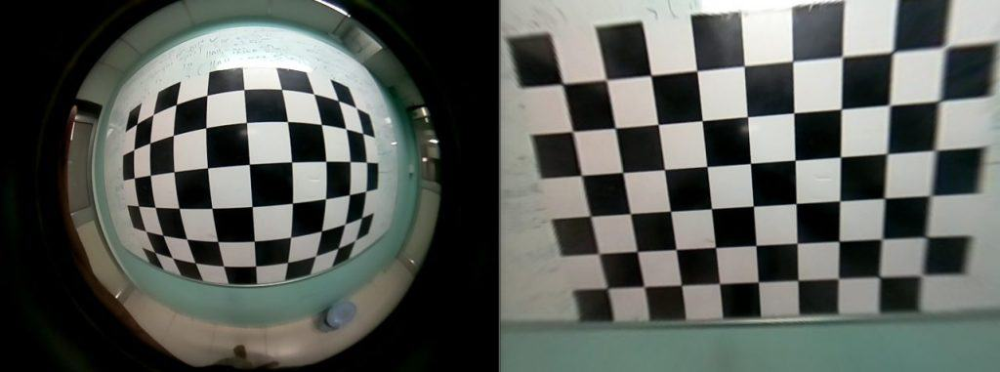

Effect of geometric correction on distorted image.

 Camera calibration using OpenCV

To understand the process of calibration, we need a,b,c,d about [Geometry of image formation](https://docs.google.com/document/d/1Y5Exd6HcRlnyWjBLrYbpiWsbSZOrXotDzhoJiceDh2E/edit?usp=sharing)


As explained in the post, to find the projection of a 3D point onto the image plane, we first need to transform the point from world coordinate system to the camera coordinate system using the extrinsic parameters (Rotation \mathbf{R} and Translation \mathbf{t}).

Next, using the intrinsic parameters of the camera, we project the point onto the image plane.

The equations that relate 3D point (X_w, Y_w, Z_w) in world coordinates to its projection (u, v) in the image coordinates are shown below

  \begin{align*} \begin{bmatrix}  u' \\ v' \\ z'  \end{bmatrix}  &=  \mathbf{P} \begin{bmatrix} X_w \\ Y_w \\ Z_w \\ 1 \end{bmatrix} \\ u &= \frac{u'}{w'} \\  v &= \frac{v'}{w'} \end{align*}
Where, \mathbf{P} is a 3×4 Projection matrix consisting of two parts — the intrinsic matrix (K) that contains the intrinsic parameters and the extrinsic matrix ([\mathbf{R} \mid  \mathbf{t}] ) that is combination of 3×3 rotation matrix \mathbf{R} and a 3×1 translation \mathbf{t} vector.

  \begin{align*}     \mathbf{P} &= \overbrace{\mathbf{K}}^\text{Intrinsic Matrix} \times \overbrace{[\mathbf{R} \mid  \mathbf{t}]}^\text{Extrinsic Matrix} \\[0.5em] \end{align*}
As mentioned in the previous post, the intrinsic matrix K is upper triangular

  \begin{align*}     \mathbf{K} & = \begin{bmatrix}  f_x & \gamma & c_x \\ 0 & f_y & c_y \\ 0 & 0 & 1  \end{bmatrix} \end{align*}
where,

*f_x, f_y* are the x and y focal lengths ( yes, they are usually the same ).

*c_x, c_y* are the x and y coordinates of the optical center in the image plane. Using the center of the image is usually a good enough approximation.

\gamma is the skew between the axes. It is usually 0.

 Goal of camera calibration

The goal of the calibration process is to find the 3×3 matrix K, the 3×3 rotation matrix \mathbf{R}, and the 3×1 translation vector \mathbf{t} using a set of known 3D points (X_w, Y_w, Z_w) and their corresponding image coordinates (u, v). When we get the values of intrinsic and extrinsic parameters the camera is said to be calibrated.

In summary, a camera calibration algorithm has the following inputs and outputs

**Inputs :** A collection of images with points whose 2D image coordinates and 3D world coordinates are known.

**Outputs:** The 3×3 camera intrinsic matrix, the rotation and translation of each image.
Note : In OpenCV the camera intrinsic matrix does not have the skew parameter. So the matrix is of the form \begin{bmatrix}f_x & 0 & c_x \\ 0 & f_y & c_y\\ 0 & 0 & 1\end{bmatrix}

**Different types of camera calibration methods**
Following are the major types of camera calibration methods:

1. Calibration pattern: When we have complete control over the imaging process, the best way to perform calibration is to capture several images of an object or pattern of known dimensions from different view points. The checkerboard based method that we will learn in this post belongs to this category. We can also use circular patterns of known dimensions instead of checker board pattern.
2. Geometric clues: Sometimes we have other geometric clues in the scene like straight lines and vanishing points which can be used for calibration.
3. Deep Learning based: When we have very little control over the imaging setup (e.g. we have a single image of the scene), it may still be possible to obtain calibration information of the camera using a Deep Learning based method.

**Camera Calibration Step by Step**

The calibration process is explained by a flowchart given below

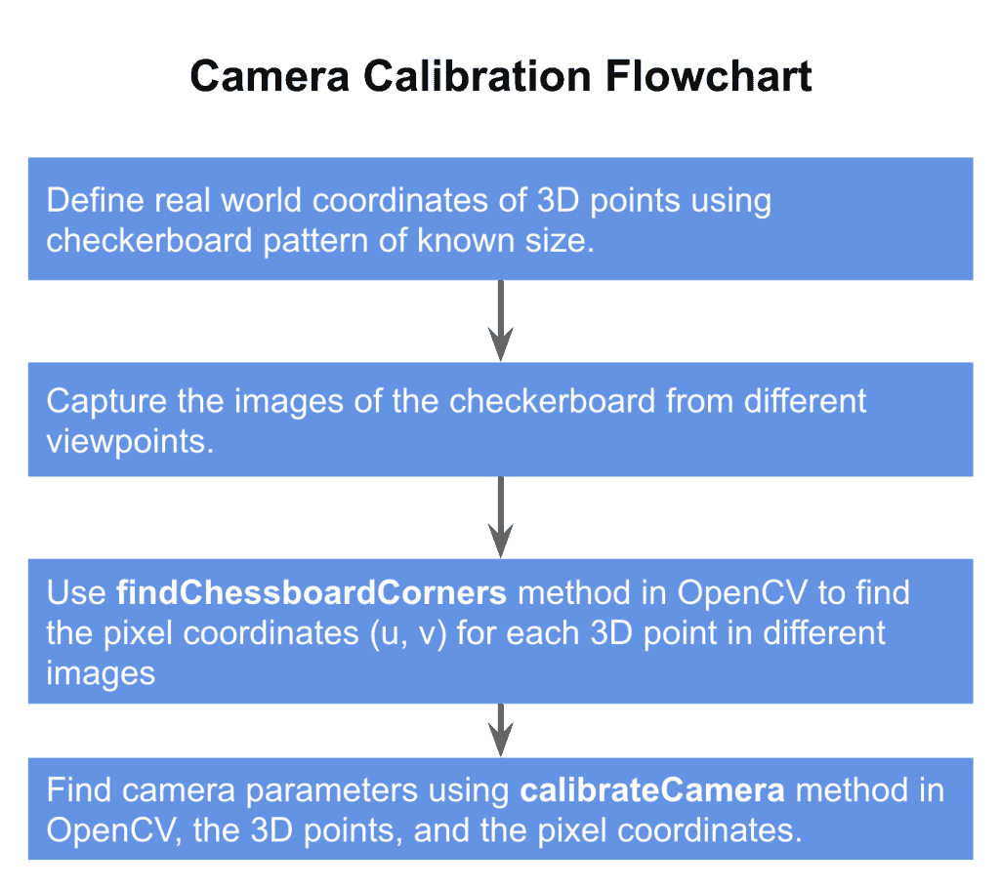

Let’s go over these steps.
Steps:
1. Define real world coordinates with checkerboard pattern
Checkerboard pattern
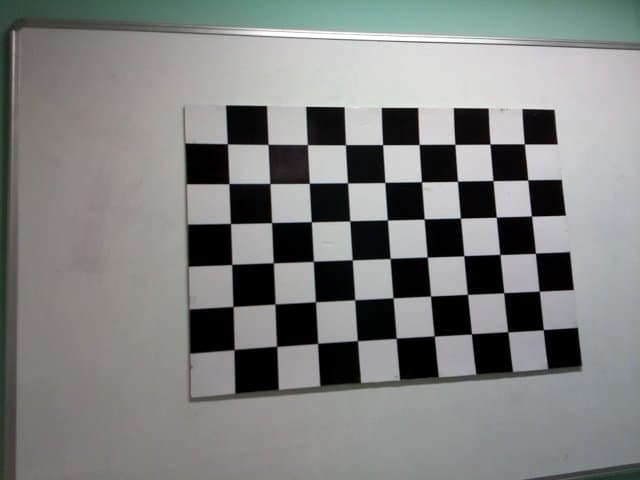
World Coordinate System : Our world coordinates are fixed by this checkerboard pattern that is attached to a wall in the room. Our 3D points are the corners of the squares in the checkerboard. Any corner of the above board can be chosen to the origin of the world coordinate system. The \mathbf{X_w} and \mathbf{Y_w} axes are along the wall, and the \mathbf{Z_w} axis is perpendicular to the wall. All points on the checkerboard are therefore on the XY plane ( i.e. Z_w = 0 ).

  In the process of calibration we calculate the camera parameters by a set of know 3D points (X_w, Y_w, Z_w) and their corresponding pixel location (u,v) in the image.

  For the 3D points we photograph a checkerboard pattern with known dimensions at many different orientations. The world coordinate is attached to the checkerboard and since all the corner points lie on a plane, we can arbitrarily choose Z_w for every point to be 0. Since points are equally spaced in the checkerboard, the (X_w, Y_w) coordinates of each 3D point are easily defined by taking one point as reference (0, 0) and defining remaining with respect to that reference point.

  Why is the checkerboard pattern so widely used in calibration?
Checkerboard patterns are distinct and easy to detect in an image. Not only that, the corners of squares on the checkerboard are ideal for localizing them because they have sharp gradients in two directions. In addition, these corners are also related by the fact that they are at the intersection of checkerboard lines. All these facts are used to robustly locate the corners of the squares in a checkerboard pattern.
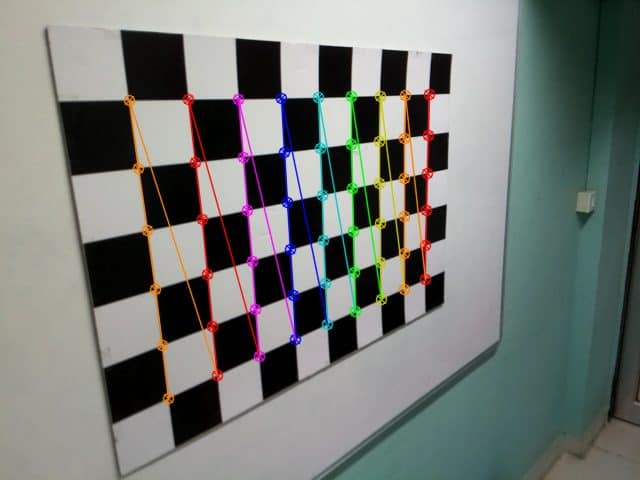

Result after drawing the detected checker board corners
Result after drawing the detected checker board corners
2. Capture multiple images of the checkerboard from different viewpoints

These above images are used for calibrating the camera
Next, we keep the checkerboard static and take multiple images of the checkerboard by moving the camera.
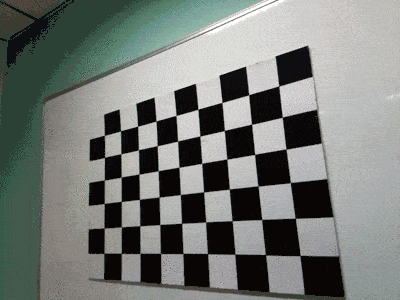

Alternatively, we can also keep the camera constant and photograph the checkerboard pattern at different orientations. The two situations are similar mathematically.

3. Find 2D coordinates of checkerboard
We now have multiple of images of the checkerboard. We also know the 3D location of points on the checkerboard in world coordinates. The last thing we need are the 2D pixel locations of these checkerboard corners in the images.

3.1 Find checkerboard corners
OpenCV provides a builtin function called findChessboardCorners that looks for a checkerboard and returns the coordinates of the corners. Let’ see the usage in the code block below. Its usage is given by

3.2 Refine checkerboard corners
Good calibration is all about precision. To get good results it is important to obtain the location of corners with sub-pixel level of accuracy.

OpenCV’s function cornerSubPix takes in the original image, and the location of corners, and looks for the best corner location inside a small neighborhood of the original location. The algorithm is iterative in nature and therefore we need to specify the termination criteria ( e.g. number of iterations and/or the accuracy )

Step 4: Calibrate Camera
The final step of calibration is to pass the 3D points in world coordinates and their 2D locations in all images to OpenCV’s calibrateCamera method. The implementation is based on a paper by Zhengyou Zhang. The math is a bit involved and requires a background in linear algebra.

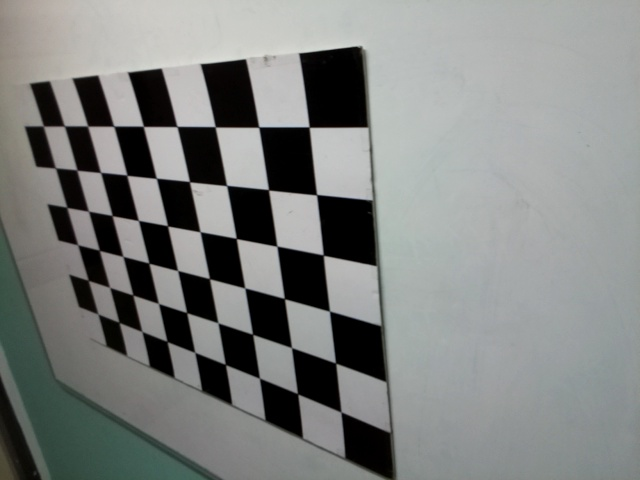

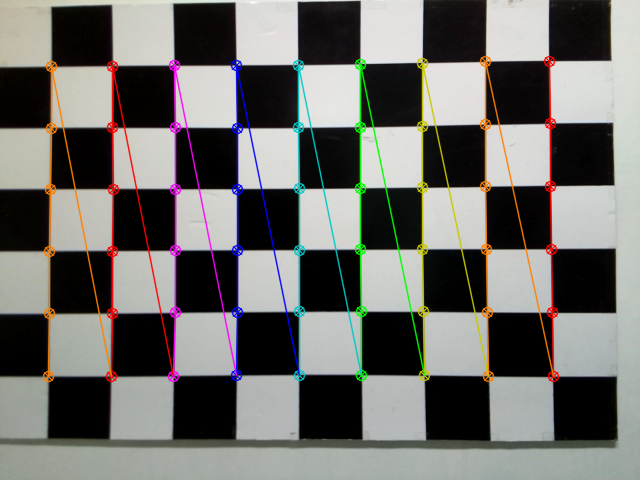

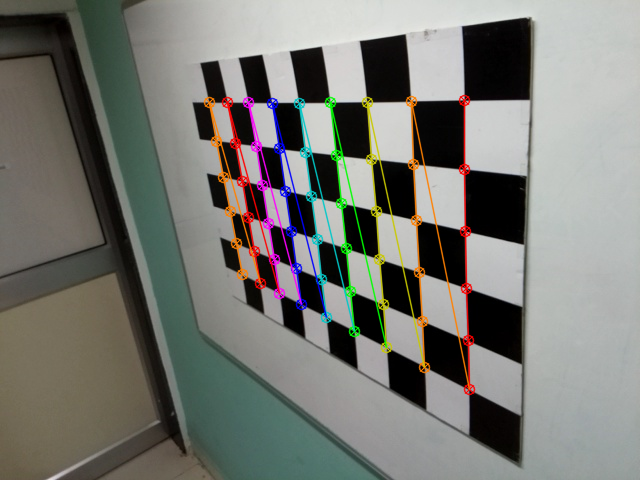

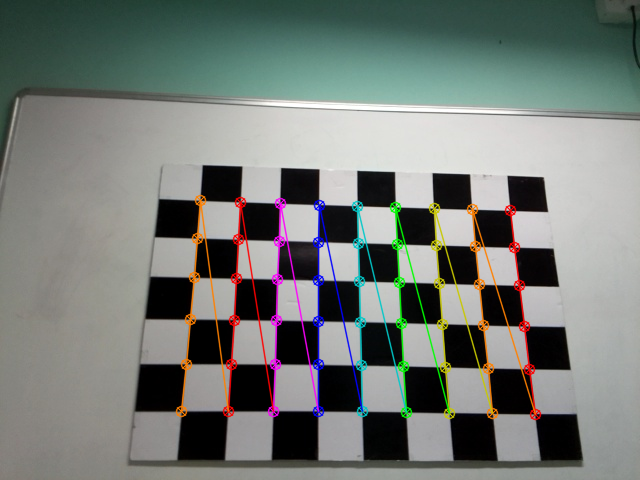

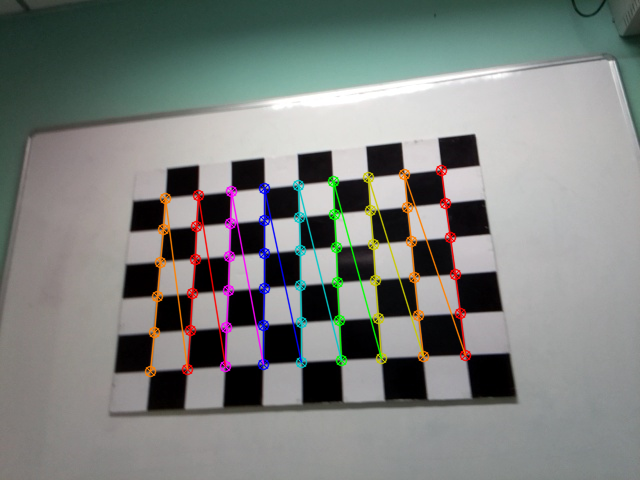

...

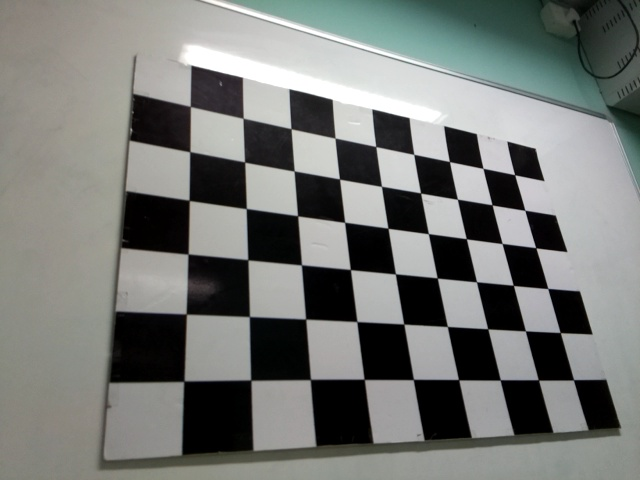

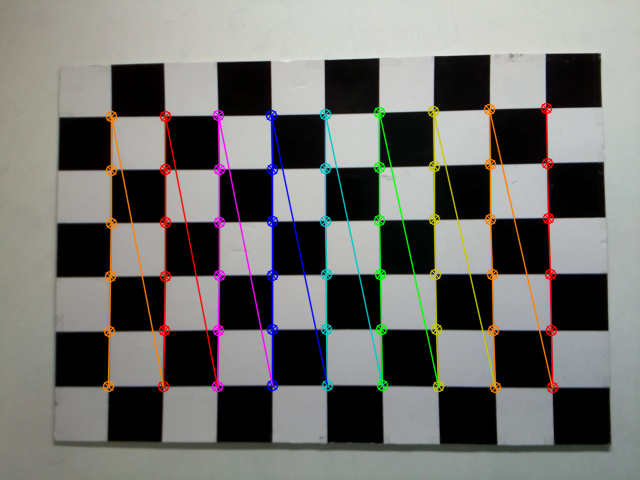

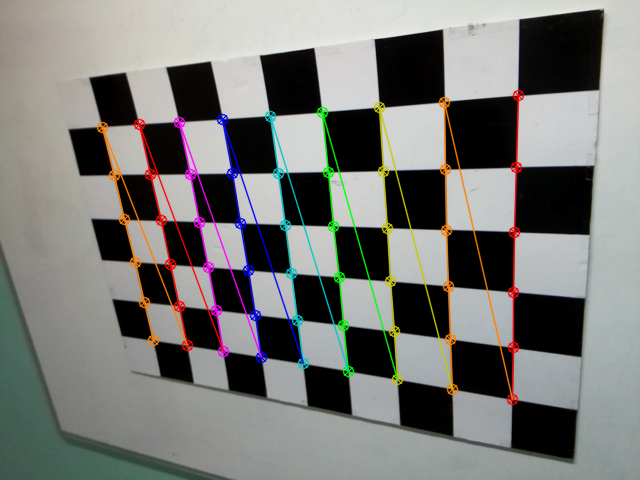

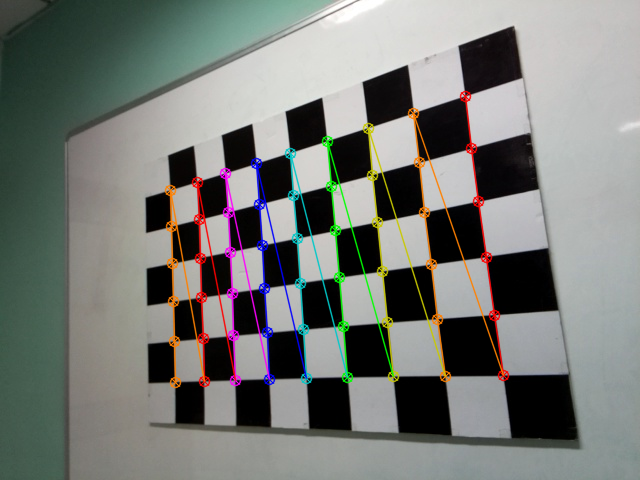

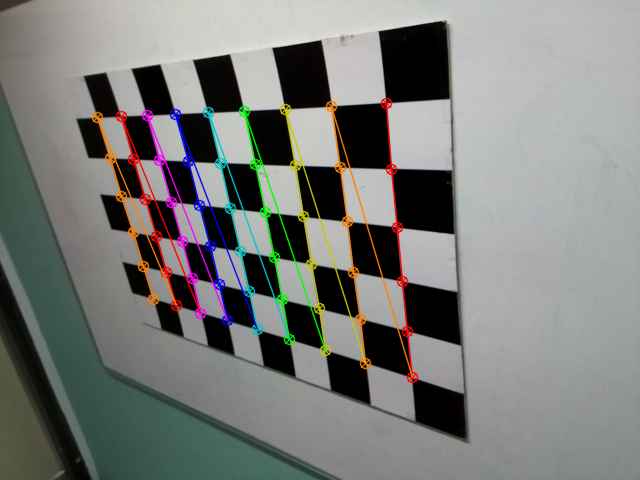

Camera matrix : 

[[503.68477278   0.         313.67563673]
 [  0.         503.37989194 243.25575477]
 [  0.           0.           1.        ]]
dist_coeff's : 

[[ 2.08346324e-01 -4.68650267e-01  4.51079184e-04 -1.93373894e-03
   2.37592401e-01]]
rotational vectors : 

(array([[-9.09292374e-04],
       [ 3.66898485e-02],
       [ 1.56666819e+00]]), array([[1.02215382],
       [0.41241127],
       [1.47957469]]), array([[-0.29895082],
       [ 0.18643046],
       [ 1.57442937]]), array([[-0.15347862],
       [ 0.39951894],
       [ 1.49239868]]), array([[-0.23749973],
       [ 0.22031738],
       [ 1.55996673]]), array([[-0.21575755],
       [ 0.38055436],
       [ 1.50528033]]), array([[-0.23343341],
       [-0.04621596],
       [ 1.522275  ]]), array([[-0.69506538],
       [-0.57631163],
       [ 1.45019819]]), array([[-0.1929761 ],
       [ 0.37179966],
       [ 1.55313095]]), array([[-0.40676505],
       [-0.72194813],
       [ 1.36334531]]), array([[-0.01540714],
       [ 0.086811

In [ ]:
#!/usr/bin/env python
from google.colab.patches import cv2_imshow
import cv2
import numpy as np
import os
import glob

# Defining the dimensions of checkerboard
CHECKERBOARD = (6,9)
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001)

# Creating vector to store vectors of 3D points for each checkerboard image
objpoints = []
# Creating vector to store vectors of 2D points for each checkerboard image
imgpoints = []


# Defining the world coordinates for 3D points
objp = np.zeros((1, CHECKERBOARD[0] * CHECKERBOARD[1], 3), np.float32)
objp[0,:,:2] = np.mgrid[0:CHECKERBOARD[0], 0:CHECKERBOARD[1]].T.reshape(-1, 2)
prev_img_shape = None

# Extracting path of individual image stored in a given directory
images = glob.glob('/content/learnopencv/CameraCalibration/images/*.jpg')
for fname in images:
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    # Find the chess board corners
    # If desired number of corners are found in the image then ret = true
    ret, corners = cv2.findChessboardCorners(gray, CHECKERBOARD, cv2.CALIB_CB_ADAPTIVE_THRESH + cv2.CALIB_CB_FAST_CHECK + cv2.CALIB_CB_NORMALIZE_IMAGE)

    """
    If desired number of corner are detected,
    we refine the pixel coordinates and display
    them on the images of checker board
    """
    if ret == True:
        objpoints.append(objp)
        # refining pixel coordinates for given 2d points.
        corners2 = cv2.cornerSubPix(gray, corners, (11,11),(-1,-1), criteria)

        imgpoints.append(corners2)

        # Draw and display the corners
        img = cv2.drawChessboardCorners(img, CHECKERBOARD, corners2, ret)

    cv2_imshow(img)
    cv2.waitKey(0)

cv2.destroyAllWindows()

h,w = img.shape[:2]

"""
Performing camera calibration by
passing the value of known 3D points (objpoints)
and corresponding pixel coordinates of the
detected corners (imgpoints)
"""
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)

print("Camera matrix : \n")
print(mtx)
print("dist_coeff's : \n")
print(dist)
print("rotational vectors : \n")
print(rvecs)
print("translation vectors : \n")
print(tvecs)

In [ ]:
!git clone https://github.com/spmallick/learnopencv.git

Cloning into 'learnopencv'...
remote: Enumerating objects: 18399, done.
remote: Counting objects: 100% (887/887), done.
remote: Compressing objects: 100% (612/612), done.
remote: Total 18399 (delta 269), reused 779 (delta 221), pack-reused 17512
Receiving objects: 100% (18399/18399), 2.56 GiB | 30.66 MiB/s, done.
Resolving deltas: 100% (5277/5277), done.
Updating files: 100% (11343/11343), done.


## Understanding Lens Distoration

- The model we used was based on the pinhole camera model. The only time you use a pinhole camera is probably during an eclipse.

- The model of image formation for any real world camera involves a lens.

- Have you ever wondered why we attach a lens to our cameras? Does it affect the transformation defining the projection of a 3D points to a corresponding pixel in an image? If yes, how do we model it mathematically?

### Replacing the pinhole by a lens
To generate clear and sharp images the diameter of the aperture (hole) of a pinhole camera should be as small as possible. If we increase the size of the aperture, we know that rays from multiple points of the object would be incident on the same part of the screen creating a blurred image.

On the other hand, if we make the aperture size small, only a small number of photons hit the image sensor. As a result the image is dark and noisy.

So, smaller the aperture of the pinhole camera, more focused is the image but, at the same time, darker and noisier it is.

On the other hand, with a larger aperture, the image sensor receives more photons ( and hence more signal ). This leads to a bright image with only a small amount of noise.

How do we get a sharp image but at the same time capture more light rays to make the image bright?

We replace the pinhole by a lens thus increasing the size of the aperture through which light rays can pass. A lens allows larger number of rays to pass through the hole and because of its optical properties it can also focus them on the screen. This makes the image brighter.

Awesome! So we have bright and sharp, focused image using a lens.

### Major types of distortion effects and their cause
By using a lens we get better quality images but the lens introduces some distortion effects. There are two major types of distortion effects :

Radial distortion: This type of distortion usually occur due unequal bending of light. The rays bend more near the edges of the lens than the rays near the centre of the lens. Due to radial distortion straight lines in real world appear to be curved in the image. The light ray gets displaced radially inward or outward from its ideal location before hitting the image sensor. There are two type of radial distortion effect
Barrel distortion effect, which corresponds to negative radial displacement
Pincushion distortion effect, which corresponds to a positive radial displacement.
Tangential distortion: This usually occurs when image screen or sensor is at an angle w.r.t the lens. Thus the image seem to be tilted and stretched.
Image explaining effect of barrel distortion and pincushion distortion on a square grid.

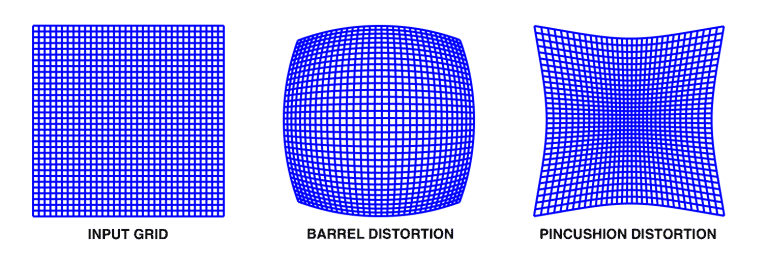![image.png]( )  

Figure 1 : Image explaining the effect of barrel distortion and pincushion distortion on a square grid.
Based on [1] there are 3 types of distortion depending on the source of distortion, radial distortion, decentering distortion and thin prism distortion. The decentering and thin prism distortion have both, radial and tangential distortion effect.
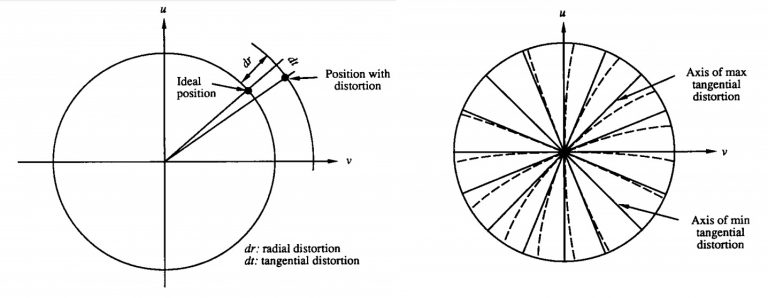]


Figure 2 : Diagrams from [1] explaining effect of tangential distortion where the solid lines represent case of no distortion and dashed lines are with tangential distortion (right) and (left) how tangential and radial distortion shifts a pixel from its ideal position.
Now we have a better idea of what types of distortion effects are introduced by a lens, but what does a distorted image look like ? Do we need to worry about the distortion introduced by the lens ? If yes why ? How do we deal with it ?

 Image showing the distortion effect. Note how the edges of the wall and doors are curved due to distortion.

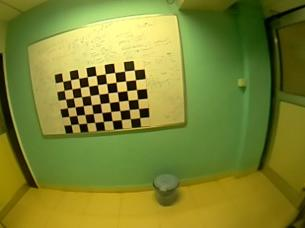


Figure 3 : Image showing the distortion effect. Note how the edges of the wall and doors are curved due to distortion.
The above figure is an example of distortion effect that a lens can introduce. You can relate figure 3 with figure 1 and say that it is a barrel distortion effect, a type of radial distortion effect. Now if you were asked to find the height of the right door, which two points would you consider ? Things become even more difficult when you are performing SLAM or making some augmented reality application with cameras having high distortion effect in the image.

### Representing the lens distortion mathematically
When we try to estimate the 3D points of the real world from an image, we need to consider these distortion effects.

We mathematically model the distortion effect based on the lens properties and combine it with the pinhole camera model that is explained in the previous post of this series. So along with intrinsic and extrinsic parameters discussed in the previous post, we also have distortion coefficients (which mathematically represent the lens distortion), as additional intrinsic parameters.

To consider these distortions in our camera model we modify the pinhole camera model as follows :

(1) \begin{equation*}  \begin{bmatrix}  X_c\\  Y_c\\  Z_c  \end{bmatrix}=\begin{bmatrix}  R |  T \end{bmatrix} \begin{bmatrix}  X_w\\  Y_w\\  Z_w  \end{bmatrix}  \end{equation*}
(2) \begin{equation*} x' = \frac{X_c}{Z_c} \end{equation*}
(3) \begin{equation*} y' = y_c/ Z_c \end{equation*}
(4) \begin{equation*} $\gamma$ = (1+ K_1r^2 + K_2r^4 + K_3r^6)/(1 + K_4r^2 + K_5r^4 + K_6r^6) \end{equation*}
(5) \begin{equation*} r^2 = x'^2 + y'^2 \end{equation*}
(6) \begin{equation*} x" = x'($\gamma$) + 2P_1x'y' + P_2(r^2 + 2x'^2) \end{equation*}
(7) \begin{equation*} y" = y'($\gamma$) + P_1(r^2 + 2y'^2) + 2P_2x'y' \end{equation*}
(8) \begin{equation*}  s*\begin{bmatrix}  x_{img}\\  y_{img}\\  1  \end{bmatrix}=\begin{bmatrix} -1/m_x & 0 & c_x\\ 0 & -1/m_y & c_y\\ 0 & 0 & 1   \end{bmatrix} \begin{bmatrix}  f & 0 & 0\\  0 & f & 0\\  0 & 0 & 1  \end{bmatrix}\begin{bmatrix}  x"\\  y"\\  1  \end{bmatrix}  \end{equation*}
The distCoeffs matrix returned by the calibrateCamera method give us the values of K_1, to K_6, which represent the radial distortion and P_1 , P_2, which represent the tangential distortion. As we know that the above mathematical model representing the lens distortion, includes all the types of distortions, radial distortion, decentering distortion and thin prism distortion, thus the coefficients K_1 to K_6 represent the net radial distortion and P_1 and P_2 represent the net tangential distortion.

### Removing the distortion using OpenCV
So what do we do after the calibration step ? We got the camera matrix and distortion coefficients in the previous post on camera calibration but how do we use the values ?

One application is to use the derived distortion coefficients to un-distort the image. Images shown below depict the effect of lens distortion and how it can be removed from the coefficients obtained from camera calibration.

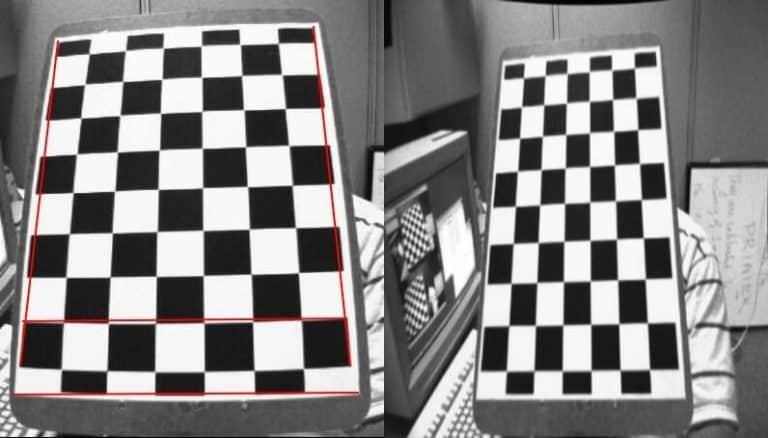

Figure 4 : Image from OpenCV documentation [2] showing effect of lens distortion.(left) and Image after performing un-distortion using the derived distortion coefficient values(right).
There are three major steps to remove distortion due to lens.

Perform camera calibration and get the intrinsic camera parameters. This is what we did in the previous post of this series. The intrinsic parameters also include the camera distortion parameters.
Refine the camera matrix to control the percentage of unwanted pixels in the undistorted image.
Using the refined camera matrix to undistort the image.
The second step is performed using the getOptimalNewCameraMatrix() method. What does this refined matrix mean and why do we need it ? Refer to the following images, in the right image we see some black pixels near the edges. These occur due to undistortion of the image. Sometimes these black pixels are not desired in the final undistorted image. Thus getOptimalNewCameraMatrix() method returns a refined camera matrix and also the ROI(region of interest) which can be used to crop the image such that all the black pixels are excluded. The percentage of unwanted pixels to be eliminated is controlled by a parameter alpha which is passed as an argument to the getOptimalNewCameraMatrix() method.

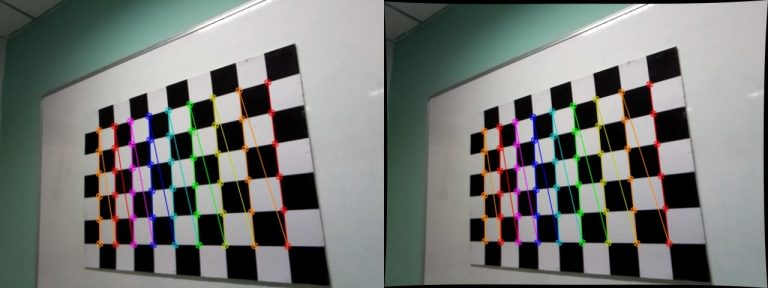
Undistorted images, with alpha=0 (left) and alpha=1 (right).

It is important to note that sometimes in case of high radial distortions, using the getOptimalNewCameraMatrix() with alpha=0 generates a blank image. This usually happens because the method gets poor estimates for the distortion at the edges. In such cases you need to recalibrate the camera and ensure that more images are taken with different views close to image borders. This way more samples near image border would be available for estimating the distortion, thus improving the estimation.

In the epipolar geometry & stereo vision article of the Introduction to spatial AI series, we discussed two essential requirements to estimate the depth (the 3D structure) of a given scene: point correspondence and the cameras’ relative position.

A quick recap:  corresponding points are pixels of different images that are projections of the same 3D point. Finding point correspondence for all the 3D points captured in both the images of a stereo image pair gives us dense correspondence, which can be used to find a dense depth map and perceive the 3D world.

We observed that it is often challenging to find dense correspondence and realized the beauty and efficiency of epipolar geometry in reducing the search space for point correspondence. We also discussed how having parallel epipolar lines further simplifies the problem, as the corresponding points relate by a horizontal displacement. This displacement is called disparity.

## Making A Low-Cost Stereo Camera Using OpenCV

how to create a custom low-cost stereo camera (using a pair of webcams ) and capture 3D videos

- We all have enjoyed 3D movies and videos like the one shown above. You need Red-Cyan color 3D glasses, like the one in figure 1, to experience the 3D effect. How does it work? How can we experience the 3D effect when the screen is just flat plane? These are captured using a stereo camera setup.

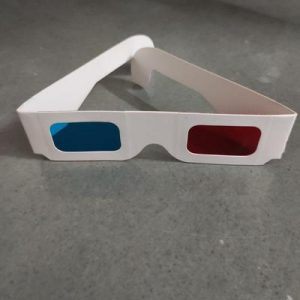



### Steps To Create The Stereo Camera Setup
A stereo camera setup usually contains two identical cameras placed a fixed distance apart. Industry grade standard stereo camera setups use an identical pair of cameras.

To create one at home, we need the following:

1. Two USB webcams (Preferably the same model).
2. Rigid base to fix the cameras (wood, cardboard, PVC foam board).
3. Clamps or Duct tape.

One can be creative in using different components to create the stereo camera, but the essential requirement is to keep the cameras rigidly fixed and parallel.

### Importance of Stereo Calibration and Rectification
To understand the importance of stereo calibration and stereo rectification, we try to generate a disparity map using the images captured from our stereo setup without any calibration or stereo rectification.

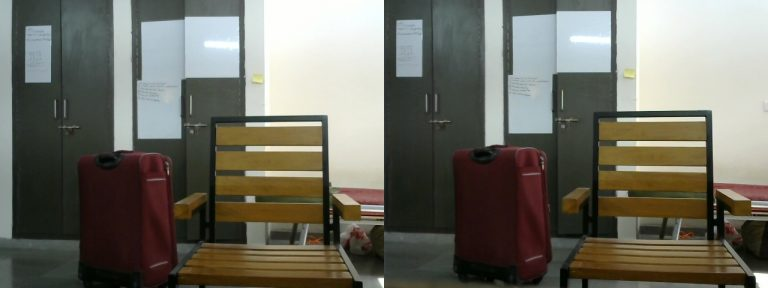

Fig 3  Left and Right images captured from the stereo camera setup

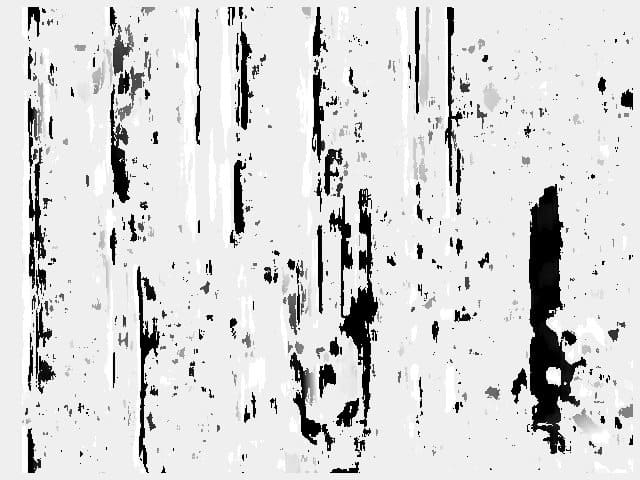

Figure 4 – Disparity map generated using the right and left images without stereo calibration
We observe that the disparity map generated with an Uncalibrated stereo camera setup is very noisy and inaccurate. Why does this happen?

Based on the previous post , the corresponding key points should have equal Y coordinates to simplify the point correspondence search. In Figure 5, when we plot the matching lines between a few corresponding points, we observe that the lines are not completely horizontal.

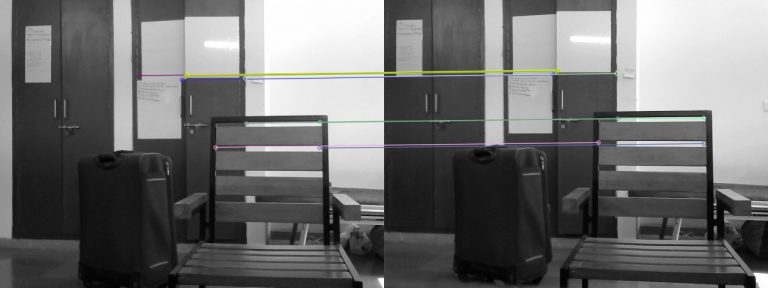

Figure 5 – Plotting matches between corresponding points.
It is also observed that the Y coordinates of corresponding points are not equal. Figure 6 shows a pair of stereo images with point correspondence, and the disparity map generated using these images. We observe that now the disparity map is less noisy compared to the previous one. In this case, the corresponding key points have equal Y coordinates. Such a case is only possible when the cameras are parallel. This is a special case of two-view geometry where the images are parallel and related by just a horizontal translation. This is essential because the method used to generate the disparity map searches only horizontally for point correspondence.




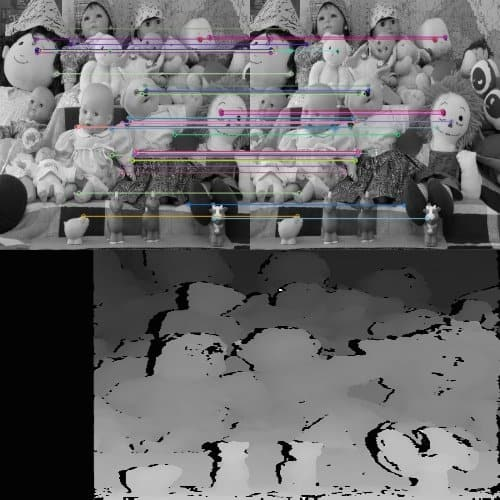

Figure 6 – Feature matches for a stereo image pair and generated disparity map.
Awesome! All we need to do is align our cameras and make them completely parallel. So do we adjust the cameras manually based on trial and error? Well, as a fun activity, you can give it a try! Spoiler alert!! It will take a long time to adjust the cameras manually to get a clear disparity map. Moreover, every time the setup is disturbed and the cameras are displaced, we have to repeat this process. This is time-consuming and not an ideal solution.

Instead of physically adjusting the cameras, we do this on the software side. We use a method called Stereo Image Rectification.[1] Figure 7 explains the process of stereo rectification. The idea is to re-project the two images on a common plane parallel to the line passing through the optical centers. This ensures that the corresponding points have the same Y coordinate and are related simply by a horizontal translation.

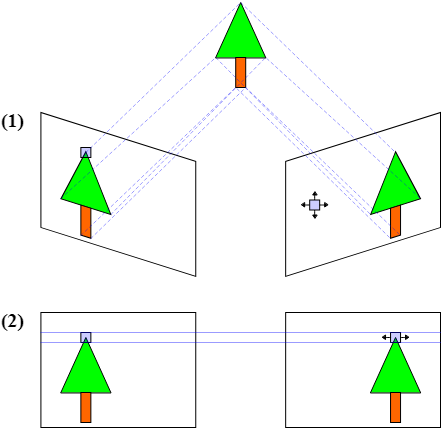

Fig 7-Process of stereo rectification



### Steps For Stereo Calibration and Rectification
Based on our previous post on lens distortion, we know that images captured by a camera suffer from lens distortion. Hence Apart from stereo rectification, it is also essential to undistort the images. So the overall process is as follows:

1. Calibrate individual cameras using the standard OpenCV calibration method explained in the camera calibration post.
2. Determine the transformation between the two cameras used in the stereo camera setup.
3. Using the parameters obtained in the previous steps and the stereoCalibrate method, we determine the transformations applied to both the images for stereo rectification.
4. Finally, a mapping required to find the undistorted and rectified stereo image pair is obtained using the initUndistortRectifyMap method.
5. This mapping is applied to the original images to get a rectified undistorted stereo image pair.

To perform these steps, we capture images of a calibration pattern. The following video shows different images captured to calibrate the DIY stereo camera.



Step 1: Individual calibration of the right and left cameras of the stereo setup

We perform individual calibration of both the cameras before performing stereo calibration. But, why do we need to calibrate the cameras individually if the stereoCalibrate() method can also perform calibration of each of the two cameras?

As there are many parameters to calculate (large parameter space) and there is accumulation of errors in steps like corner detection and approximating points to integers. This increases the chances of the iterative method to diverge from the correct solution. Hence we calculate the camera parameters individually and use the stereoCalibrate() method only to find the transformation between the stereo camera pair, the Essential matrix and the Fundamental matrix.

But how will the algorithm know that the calibration of individual cameras is to be skipped? For this we set the flag CALIB_FIX_INTRINSIC and pass it to the method.

Step 2: Performing stereo calibration with fixed intrinsic parameters
As the cameras are calibrated, we pass them to the stereoCalibrate() method and set the CALIB_FIX_INTRINSIC flag. We also pass the 3D points and corresponding 2D pixel coordinates captured in both images.

The method computes the rotation and translation between the two cameras and the Essential and Fundamental matrix.

Step 3: Stereo Rectification
Using the camera intrinsics and the rotation and translation between the cameras, we can now apply stereo rectification. Stereo rectification applies rotations to make both camera image planes be in the same plane. Along with the rotation matrices, the stereoRectify method also returns the projection matrices in the new coordinate space.

Step 4: Compute the mapping required to obtain the undistorted rectified stereo image pair
As we assume that the cameras are rigidly fixed, the transformations need not be calculated again. Hence we calculate the mappings that transform a stereo image pair to an undistorted rectified stereo image pair and store them for further use.

### How Do 3D Glasses Work?
Once our DIY stereo camera is calibrated, we are ready to create 3D videos. But before we understand how to make 3D videos, it is essential to understand how the 3D glasses work.

We perceive the world using a binocular vision system. Our eyes are in laterally varying positions. Hence they capture somewhat different information.

What is the difference between the information captured by our left and right eye?

Let’s do a simple experiment! Stretch your arm in front and hold any object in your hand. Now, look at the object with one eye closed. After a second, repeat this with the other eye and keep alternating. Do you observe any difference in what both your eyes can see?

The differences are mainly in the relative horizontal position of objects. These positional differences are referred to as horizontal disparities. In the previous post, we had calculated a disparity map using a pair of stereo images.

Now, bring the object closer to you and repeat the same experiment. What changes did you observe now? The horizontal disparities corresponding to the object increase. Hence, the higher the disparities for an object, the closer it is. This is how we use stereopsis to perceive depth using our binocular vision system.

We can simulate such disparities by artificially presenting two different images separately to each eye using a method called stereoscopy. Initially, for 3D movies, people achieved by encoding each eye’s image using filters of red and cyan colors. They used the red-cyan 3D glasses to ensure that each of the two images reached the intended eye. This created the illusion of depth. The stereoscopic effect generated with this method is called anaglyph 3D. Hence, the images are called anaglyph images, and the glasses are called anaglyph 3D glasses.

## stereo camera depth estimation with opencv


In the making a low cost stereo camera using OpenCV article of the Introduction to spatial AI series, we created a custom low- cost stereo camera. We also discussed stereo rectification and calibration. Stereo rectification and calibration are performed to make the epipolar lines horizontal. These calculations make it easy to find dense correspondence.

This post discusses Block Matching and Semi-Global Block Matching methods to find dense correspondence and a disparity map for a rectified stereo image pair. We will also learn how to find depth maps from the disparity map. Finally, we will look at how to use depth estimation to create an obstacle avoidance system.

### Block Matching For Dense Stereo Correspondence
Given we have a horizontal stereo camera setup, the corresponding points for a rectified stereo image pair would have the same Y coordinate. So how do we go about finding the corresponding points?

One can think of a naive approach to compare the pixel values in the same row of the stereo image pair. However, this is not a robust method. Multiple pixels corresponding to different images can have the same pixel intensity. Moreover, considering practical constraints such as differences in the imaging sensors or exposure values, corresponding pixels may have unequal pixel values.

Block Matching Algo:

A better approach is to consider some **neighboring pixels** as well.
This is what we do in the block-matching algorithm. The row which we scan for stereo correspondence is called **scanline**. This sounds great! But how do we quantify the best match? Is there any metric that can be used to quantify how well the windows match?

There are multiple metrics, such as
* the Sum of Absolute Differences (SAD),
* Sum of Squared Differences (SSD), and
* Normalized Cross Correlation (NCC),
that can be used to quantify the match.

For example, the pair with the lowest SAD score is the best match, as the overall pixel-wise sum is the least. Figure 1 shows the scanline and reference block in the stereo image pair. The plot for SAD of the respective scanline is shown in the rightmost image.

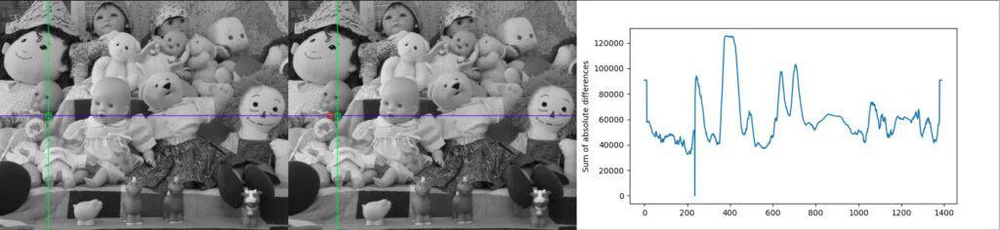

Figure 1 – Left image shows the scanline along with the target window.
Center image shows the scanline (blue), best matching block (green) and second best matching block(red).
The right image is the plot for Sum of Absolute Difference (SAD) between the reference block from the left image, and the sliding window along the scanline in the right image.

The above method gives us only one corresponding pair. We want to find correspondence for all the pixels on the scanline. A straightforward solution is to repeat the process for all the pixels on the scanline. However, this will lead to a noisy output. Practically it is impossible to get a one-to-one correspondence for any scanline. There can be multiple matches for a given block (in case of repeating texture or texture-less regions), or there can be no ideal match (due to occlusion).

### Dynamic Programming and the Scanline
Dynamic programming is a standard method to enforce a scanline’s one-to-one correspondence. The aim is to find the one-to-one correspondence for the scanline, which results in the least possible overall cost, so we overcome the practical challenges mentioned above.

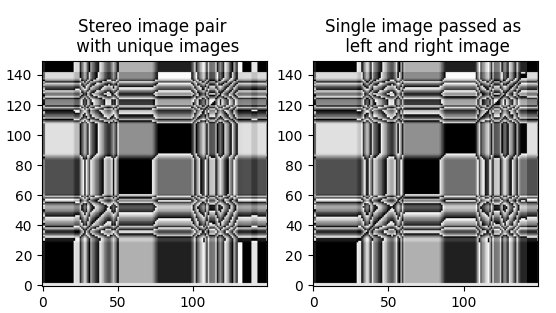

Figure 2 – Sum of Absolute Differences (SAD) values for a given scanline.


Figure 2 shows SAD values for a given scanline. The left figure corresponds to a stereo image pair of unique images, and the right figure shows the SAD values for the same scanline when a single image is used, passing it twice for comparison.

### SAD Values Explained
Brighter values represent a greater mismatch, and darker values represent a better match. To find the correspondence, we need to find the path from the bottom left corner to the top right corner such that the sum of values covered by the path is minimum. In the case of the right image of Figure 2, such a path is clearly visible along the diagonal (a thin black line from the bottom left corner to the top right corner). In the case of the left figure, the diagonal line contains some brighter values as well (due to occlusion, there is no matching block hence even the least SAD value is relatively bright).

OpenCV provides an implementation for the Block Matching algorithm – StereoBM class. The method of the StereoBM class calculates a disparity map for a pair of rectified stereo images. Various combinations of a stereo camera setup are possible depending on the type of camera sensors, the distance between the cameras, and many other factors. Hence, a fixed set of parameters cannot give good quality of disparity map for all possible combinations of a stereo camera setup.

###we can tune the param's

Understanding The Effect of Each Parameter:

- A number of disparities (numDisparities): Sets the range of disparity values to be searched. The overall range is from minimum to minimum disparity value + several disparities. The following images show the disparity map calculated for two different disparity ranges. It is clearly visible that increasing the number of disparities increases the accuracy of the disparity map.

- Block size (blockSize): Size of the sliding window used for block matching to find corresponding pixels in a rectified stereo image pair. A higher value indicates a larger window size. The following GIF indicates that increasing this parameter results in more smooth disparity maps.
- Pre-Filter Type (preFilterType): Parameter to decide the type of pre-filtering to be applied to the images before passing to the block matching algorithm. This step enhances the texture information and improves the results of the block-matching algorithm. The filter type can be CV_STEREO_BM_XSOBEL or CV_STEREO_BM_NORMALIZED_RESPONSE.
- Pre-filter size (preFilterSize): Window size of the filter used in the pre-filtering stage.
- Pre-filter cap (preFilterCap): Limits the filtered output to a specific value.
- Minimum disparity (minDisparity): The minimum value of the disparity to be searched. In most scenarios it is set to zero. It can also be set to negative value depending on the stereo camera setup.
- Texture threshold (textureThreshold): Filters out areas that do not have enough texture information for reliable matching.
- Uniqueness Ratio (uniquenessRatio): Another post-filtering step. The pixel is filtered out if the best matching disparity is not sufficiently better than every other disparity in the search range. The following GIF depicts that increasing the uniqueness ratio increases the number of pixels that are filtered out.
- Speckle range (speckleRange) and speckle window size (speckleWindowSize): Speckles are produced near the boundaries of the objects, where the matching window catches the foreground on one side and the background on the other. To get rid of these artifacts, we apply speckle filter which has two parameters. The speckle range defines how close the disparity values should be to be considered as part of the same blob. The speckle window size is the number of pixels below which a disparity blob is dismissed as “speckle”.
- disp12MaxDiff: Pixels are matched both ways, from the left image to the right image and from the right image to left image. disp12MaxDiff defines the maximum allowable difference between the original left pixel and the back-matched pixel.

### Extra ref's:
A significant point to note is that the method of the block matching class returns a 16-bit signed single-channel image containing disparity values scaled by 16. Hence, to get the actual disparity values from such fixed-point representation, we need to divide the disparity values by 16.

OpenCV also provides StereoSGBM, which implements Hirschmüller’s original SGM [2] algorithm. SGBM stands for Semi-Global Block Matching. It also implements the sub-pixel estimation proposed by Brichfield et al. [3]

In the case of simple block matching, sometimes using the minimum cost can give wrong matches.  Note that wrong matches can have a lower cost than correct matches. Hence SGBM applies additional constraints to increase smoothness by penalizing changes of disparities in the 8-connected neighborhood. For the constraint, 1-D minimum cost paths from multiple directions are aggregated.

The block-matching-based algorithms are classical computer vision algorithms. After the advent of deep neural networks, several deep learning architectures have been proposed to find dense correspondence between a stereo image pair. For further details, refer to our article on stereo matching.

### From disparity map to depth map
Till now, the grayscale  images we have been obtaining are just the disparity maps and not the depth maps. Using block matching methods, we calculated dense correspondences for a rectified stereo image pair.. We calculated the disparity for each pixel with the help of these dense correspondences ( shift between the corresponding pixels). Our earlier article on epipolar geometry provides a good intuition of how disparity is related to depth.

In this post, we improve our understanding of how depth relates to disparity and derive an expression for calculating depth from disparity. The following figure helps visualize the derivation of the expression.

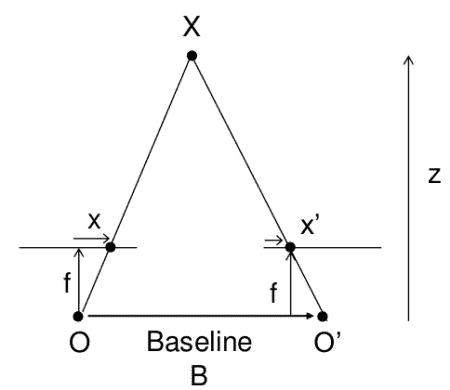
Figure 5– Figure showing the relation between depth Z and disparity (x – x’).

From the above figure, we can derive the relation between disparity (x – x’) and depth Z as follows:

(1) \begin{equation*} disparity = x - x' = \frac{Bf}{Z} \end{equation*}
Here B is the baseline of the stereo camera setup, and f is the focal length.

Now in the case of a practical setup, the focal length f of both the cameras is not identical, and moreover, manually measuring B can also lead to errors. This leads us to an important question – what should be the value of f and B, and how do we derive it?

We derive it experimentally. The above equation can also be written as follows:

(2) \begin{equation*} x-x' = M \frac{1}{Z} \end{equation*}
Where

(3) \begin{equation*} Bf = M  \end{equation*}
By creating a GUI that displays a targeted pixel’s disparity values, we can practically measure its distance from the camera (Z).  Based on multiple disparity readings and Z (depth), we can solve for M by formulating a least-squares problem.  The following graphs depict the relation between depth and disparity for a stereo camera setup highlighting the data points obtained from different observations.

Stereo Camera Depth Estimation - Image with graphs, showing the relation between depth and disparity values for a stereo camera setup.

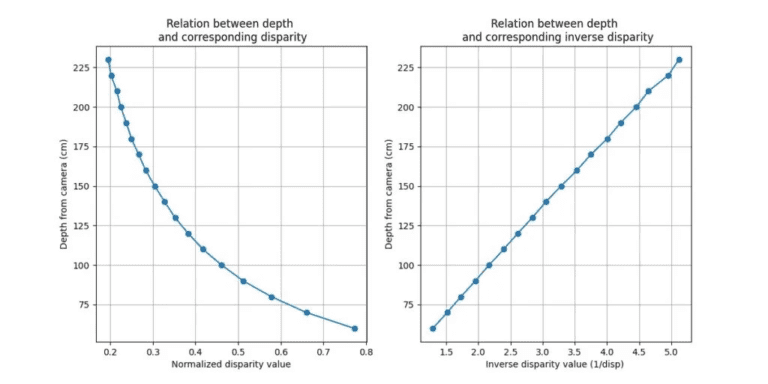

Figure 6 – Graphs showing the relation between depth and disparity values for a stereo camera setup.
Okay! The least-squares problem sounds fun. But what exactly does it mean? And how do we code it?

First, we will rearrange the previous equation as follows:

(4) \begin{equation*} Z = M \frac{1}{x-x'} \end{equation*}
By substituting

(5) \begin{equation*} \frac{1}{x-x'} = a  \end{equation*}
we get the following equation:

(6) \begin{equation*} Z = M \times a \end{equation*}
This is relatively easy, right? We need a single reading of (Z,a) to calculate M (One equation, one variable). Why do we need multiple readings, and why do we use the least-squares method? Well, this is because nothing is perfect in a practical world!

There is always a chance of error when we talk about practical scenarios. In this case, there can be a human error (in measuring the distance Z), or the disparity values calculated by the algorithm can be a bit inaccurate. Also, quantization of the disparity values induces some error. Hence, depending on a single reading is not a good idea.

So, we take multiple readings of (Z,a). Hence the number of equations exceeds the number of variables. The least-squares method helps find the value of M that best agrees with all the readings. Graphically, it is the process of finding a line such that the sum of squared distances of all the data points from the line is the least.

In [ ]:
# solving for M in the following equation
# ||    depth = M * (1/disparity)   ||
# for N data points coeff is Nx2 matrix with values
# 1/disparity, 1
# and depth is Nx1 matrix with depth values
ret, sol = cv2.solve(coeff,z,flags=cv2.DECOMP_QR)

Once we solve for M, we can convert the disparity map to the depth map by adding the following equation to our code after calculating the disparity map:

(7) \begin{equation*} depthmap = \frac{M}{disparity} \end{equation*}
The following video illustrates the process of capturing multiple readings of disparity values and corresponding depth values using the code shared with this post. It is better to take as many readings as possible for a more accurate solution.

###Obstacle avoidance system
The basic concept of obstacle avoidance is determining if the distance of any object from the sensor is closer than the minimum threshold distance. In our case, the sensor is a stereo camera.  Another type of device widely used for distance measurement and obstacle avoidance is an ultrasonic sensor.

Unlike stereo cameras, ultrasonic sensors work on the propagation of signals. A signal of known frequency is emitted. It travels until an object obstructs its path. It gets reflected from the object, and the sensor receives the reflected signal.  If the signal’s speed is known, the time elapsed between the transmission and receiving of the signal can be used to calculate the object’s distance from the sensor. Bats use a similar method to navigate and avoid obstacles.

A stereo camera’s key advantage over an ultrasonic sensor is that the stereo camera provides a greater field of view.

Steps to build an obstacle avoidance system
So how do we create an obstacle avoidance system using a stereo camera? The steps to build such a system are as follows:

1. Get the depth map from the stereo camera.
2. Based on a threshold (minimum depth value), determine regions in the depth map with a depth value less than the threshold. Using the inRange() method, create a mask to segment such regions.
3. Apply contour detection and find the largest contour.
4. Create a new mask using the largest contour.
5. Find the average depth value using the meanStdDev() method using the mask created in step 4.
6. Perform the warning action. In our example, we display the distance of the obstacle in red color.

In [ ]:
depth_thresh = 100.0 # Threshold for SAFE distance (in cm)

# Mask to segment regions with depth less than threshold
mask = cv2.inRange(depth_map,10,depth_thresh)

# Check if a significantly large obstacle is present and filter out smaller noisy regions
if np.sum(mask)/255.0 > 0.01*mask.shape[0]*mask.shape[1]:

  # Contour detection
  contours, _ = cv2.findContours(mask, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
  cnts = sorted(contours, key=cv2.contourArea, reverse=True)

  # Check if detected contour is significantly large (to avoid multiple tiny regions)
  if cv2.contourArea(cnts[0]) > 0.01*mask.shape[0]*mask.shape[1]:

    x,y,w,h = cv2.boundingRect(cnts[0])

    # finding average depth of region represented by the largest contour
    mask2 = np.zeros_like(mask)
    cv2.drawContours(mask2, cnts, 0, (255), -1)

    # Calculating the average depth of the object closer than the safe distance
    depth_mean, _ = cv2.meanStdDev(depth_map, mask=mask2)

    # Display warning text
    cv2.putText(output_canvas, "WARNING !", (x+5,y-40), 1, 2, (0,0,255), 2, 2)
    cv2.putText(output_canvas, "Object at", (x+5,y), 1, 2, (100,10,25), 2, 2)
    cv2.putText(output_canvas, "%.2f cm"%depth_mean, (x+5,y+40), 1, 2, (100,10,25), 2, 2)

else:
  cv2.putText(output_canvas, "SAFE!", (100,100),1,3,(0,255,0),2,3)

cv2.imshow('output_canvas',output_canvas)

# Intro to epipolar geo and stereo vision

## Intro to Epipolar Geo and Stereo Vision

Have you ever wondered why you can experience that wonderful 3D effect when you watch a movie with those special 3D glasses?

Or why is it difficult to catch a cricket ball with your one eye closed?

It all relates to stereoscopic vision, which is our ability to perceive depth using both the eyes.

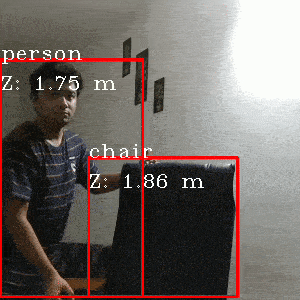

What is a stereo camera setup?

How do we use it to provide a sense of depth to a computer?

Does it have anything to do with stereoscopic vision?

Most of the post’s theoretical explanations are inspired by the book: **Multiple View Geometry in Computer Vision by Richard Hartley and Andrew Zisserman**. It is a very famous and standard textbook for understanding various fundamental concepts of computer vision.

## Do we need more than one image to calculate depth? (Triangulation)
When we capture (project) a 3D object in an image, we are projecting it from a 3D space to a 2D (planar) projective space. This is called the Planar Projection. The problem is that we lose the depth information due to this planar projection.

So how do we recover the depth? Can we calculate back the depth of a scene using a single image? Let’s try a simple example.

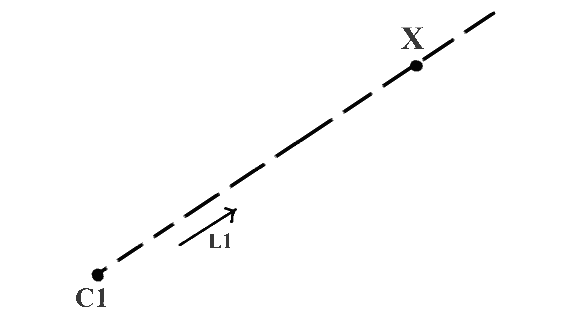

Figure 1 – Locating a 3D point (X), at an unknown depth, with a single known 3D point (C1) and direction vector (L1).

In figure 1, C1 and X are points in 3D space, and the unit vector L1 gives the direction of the ray from C1 through X. Now, can we find X if we know the values of point C1 and direction vector L1? Mathematically it simply means to solve for X in the equation

 X = C1 + k(L1)

Now, as the value of k is not known, we cannot find a unique value of X.

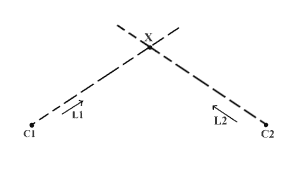

Figure 2 – Locating a 3D point (X), at an unknown depth, with two known 3D points (C1 and C2) and direction vectors (L1 and L2) – Triangulation.

In figure 2, we have an additional point C2, and L2 is the direction vector of the ray from C2 through X. Now can we find a unique value for X if C2 and L2 are also known to us?

Yes! Because the rays originating from C1 and C2 clearly intersect at a unique point, point X itself. This is called **triangulation**. We say we triangulated point X.

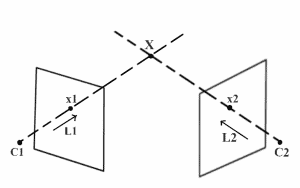

Figure 3 – Extending the triangulation concept to explain how a 3D point (X) captured in two images can be calculated if the camera positions (C1 and C2) and pixel coordinates (x1 and x2) are known.

Figure 3 shows how triangulation can be used to calculate the depth of a point (X) when captured(projected) in two different views(images). In this figure, C1 and C2 are known 3D positions of the left and right cameras, respectively. x1 is the image of the 3D point X captured by the left camera, and x2 is the image of X captured by the right camera. x1 and x2 are called corresponding points because they are the projection of the same 3D point. We use x1 and C1 to find L1 and x2 and C2 to find L2. Hence we can use triangulation to find X just like we did for figure 2.

From the above example, we learned that to triangulate a 3D point using two images capturing it from different views, the key requirements are:

- Position of the cameras – C1 and C2.
- Point correspondence – x1 and x2.

Great! It is now clear that we need more than one image to find depth.

Hey! but this was just a single 3D point that we tried to calculate. How do we calculate a 3D structure of a real-world scene by capturing it from two different views? The obvious answer is by repeating the above process for all the 3D points captured in both the views. Let’s have a closer look at the practical challenges in doing this. Time for the reality check!

### Practical and theoretical understanding of the two-view geometry

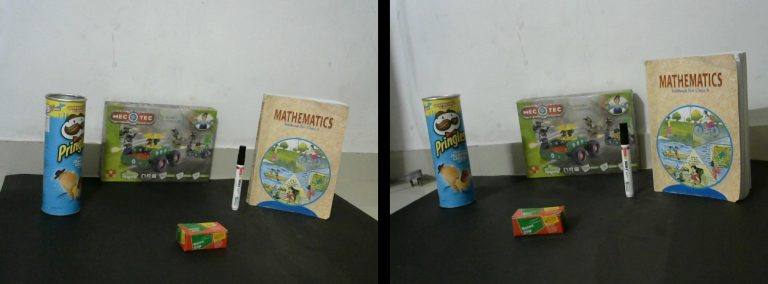


Real world scene captured from two different view points
Figure 4 – Real world scene captured from two different view points.
Figure 4 shows two images capturing a real-world scene from different viewpoints. To calculate the 3D structure, we try to find the two key requirements mentioned before:

The position of cameras in the real world coordinate system (C1 and C2). We simplify this problem by calculating the 3D points by assuming one of the camera positions (C1 or C2) as the origin. We find it by calibrating the two view system using a known calibration pattern. This process is called stereo calibration.
2. The point correspondence (x1 and x2) for each 3D point (X) in the scene to be calculated. We will discuss various improvements for calculating point correspondence and finally understand how epipolar geometry can help us to simplify the problem.

Note that the stereo camera calibration is useful only when the images are captured by a pair of cameras rigidly fixed with respect to each other. If a single camera captures the images from two different angles, then we can find depth only to a scale. The absolute depth is unknown unless we have some special geometric information about the captured scene that can be used to find the actual scale.

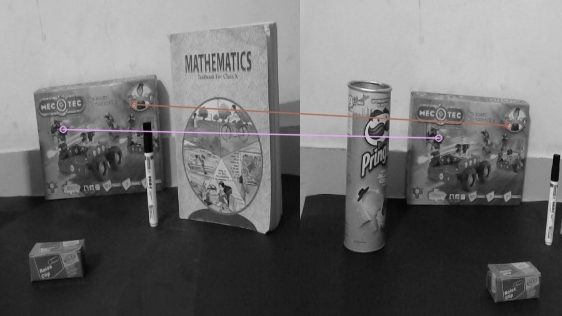


Hand picked feature matches
Figure 5 – Hand picked feature matches.
Figure 5 shows different matched points that were manually marked. It is easy for us to identify the corresponding points, but how do we make a computer do that?

One method which people regularly use in the computer vision community is called feature matching. Following figure 6 shows matched features between the left and right images using ORB feature descriptors. This is one method to find point correspondence (matches).

Feature Matching -output

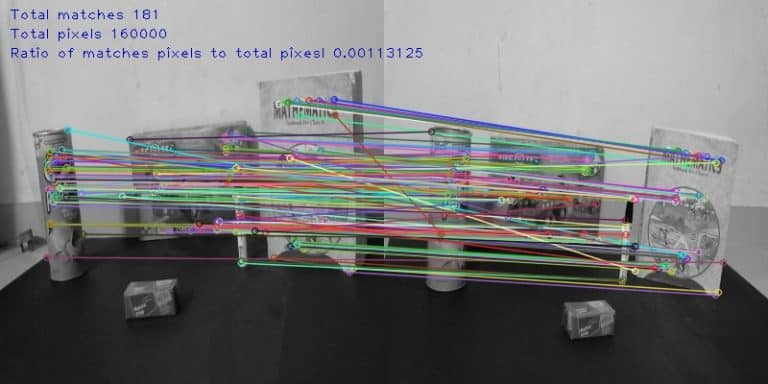


Figure 6 – Results of feature detection algorithm.
However, we observe that the ratio of the number of pixels with known point correspondence to the total number of pixels is minimal. This means we will have a very sparsely reconstructed 3D scene. For dense reconstruction, we need to obtain point correspondence for the maximum number of pixels possible.  

Multiple matched points using template matching

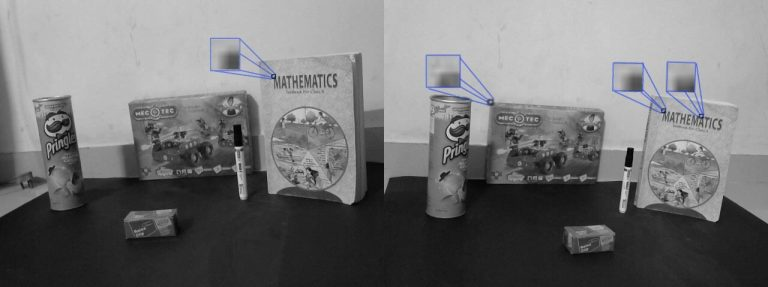


Figure 7 – Multiple matched points using template matching.
A simplified way to find the point correspondences is to find pixels with similar neighboring pixel information. In figure 7, we observe that using this method of matching pixels with similar neighboring information results in a single-pixel from one image having multiple matches in the other image. We find it challenging to write an algorithm to determine the true match.

Is there a way to reduce our search space? Some theorem which we can use to eliminate all the extra false matches that lead to inaccurate correspondence? We make use of epipolar geometry here.

All this explanation and build-up was to introduce the concept of epipolar geometry. Now we will understand the importance of epipolar geometry in reducing search space for point correspondence.

### Epipolar geometry and its use in point correspondence

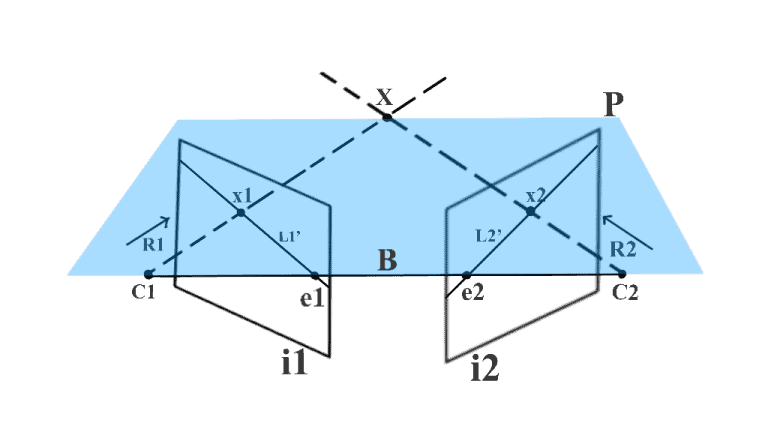

In figure 8, we assume a similar setup to figure 3. A 3D point X is captured at x1 and x2 by cameras at C1 and C2, respectively. As x1 is the projection of X, If we try to extend a ray R1 from C1 that passes through x1, it should also pass through X. This ray R1 is captured as line L2, and X is captured as x2 in the image i2. As X lies on R1, x2 should lie on L2. This way, the possible location of x2 is constrained to a single line, and hence we can say that the search space for a pixel in image i2, corresponding to pixel x1, is reduced to a single line L2. We use epipolar geometry to find L2.

Time to define some technical terms now! Along with X, we can also project the camera centers in the respective opposite images. e2 is the projection of camera center C1 in image i2, and e1 is the projection of camera center C2 in image i1. The technical term for e1 and e2 is epipole. Hence in a two-view geometry setup, an epipole is the image of the camera center of one view in the other view.

The line joining the two camera centers is called a baseline. Hence epipole can also be defined as the intersection of baseline with the image plane.

Figure 8 shows that using R1 and baseline, we can define a plane P. This plane also contains X, C1, x1, x2, and C2. We call this plane the epipolar plane. Furthermore, the line obtained from the intersection of the epipolar plane and the image plane is called the epipolar line. Hence in our example, L2 is an epipolar line. For different values of X, we will have different epipolar planes and hence different epipolar lines. However, all the epipolar planes intersect at baseline, and all the epipolar lines intersect at epipole. All this together forms the epipolar geometry.

Revisiting figure 8 with all the technical terms we have learned till now.

We have epipolar plane P created using baseline B and ray R1. e1 and e2 are epipoles, and L2 is the epipolar line. Based on the epipolar geometry of the given figure, search space for pixel in image i2 corresponding to pixel x1 is constrained to a single 2D line which is the epipolar line l2. This is called the epipolar constraint.

Is there a way to represent the entire epipolar geometry by a single matrix? Furthermore, can we calculate this matrix using just the two captured images? The good news is that there is such a matrix, and it is called the Fundamental matrix.

In the next two sections, we first understand what we mean by projective geometry and homogeneous representation and then try to derive the Fundamental matrix expression. Finally, we calculate the epipolar lines and represent the epipolar constraint by using the fundamental matrix.

### Understanding projective geometry and homogeneous representation

How do we represent a line in a 2D plane? Equation of a line in a 2D plane is ax + by + c = 0. With different values of a, b, and c, we get different lines in a 2D plane. Hence a vector (a,b,c) can be used to represent a line.

Suppose we have line ln1 defined as 2x + 3y + 7 = 0 and line ln2 as 4x + 6y + 14 = 0. Based on our above discussion, l1 can be represented by the vector (2,3,7) and l2 by the vector (4,6,14). We can easily say that l1 and l2 essentially represent the same line and that the vector (4,6,14) is basically the scaled version of the vector (2,3,7), scaled by a factor of 2.

Hence any two vectors (a,b,c) and k(a,b,c), where k is a non-zero scaling constant, represent the same line. Such equivalent vectors, which are related by just a scaling constant, form a class of homogeneous vectors. The vector (a,b,c) is the homogeneous representation of its respective equivalent vector class.

The set of all equivalent classes, represented by (a,b,c), for all possible real values of a, b, and c other than a=b=c=0, forms the projective space. We use the homogeneous representation of homogeneous coordinates to define elements like points, lines, planes, etc., in projective space. We use the rules of projective geometry to perform any transformations on these elements in the projective space.

Fundamental matrix derivation
In figure 3, Assume that we know the camera projection matrices for both the cameras, say P1 for the camera at C1 and P2 for the camera at C2.

What is a projection matrix? The camera’s projection matrix defines the relation between the 3D world coordinates and their corresponding pixel coordinates when captured by the camera. To know more about the camera projection matrix, read this post on camera calibration.  

Just like P1 projects 3D world coordinates to image coordinates, we define P1inv, the pseudo inverse of P1, such that we can define the ray R1 from C1 passing through x1 and X as:

 X(k) = P1inv \times x1 + kC1
k is a scaling parameter as we do not know the actual distance of X from C1. We need to find the epipolar line Ln2 to reduce the search space for a pixel in i2 corresponding to pixel x1 in i1 as we know that Ln2 is the image of ray R1 captured in i2. Hence to calculate Ln2, we first find two points on ray R1, project them in image i2 using P2 and use the projected images of the two points to find Ln2.

The first point that we can consider on R1 is C1, as the ray starts from this point. The second point can be calculated by keeping k=0. Hence we get the points as C1 and (P1inv)(x1).

Using the projection matrix P2 we get the image coordinates of these points in the image i2 as P2*C1 and P2*P1inv*x1 respectively. We also observe that P2*C1 is basically the epipole e2 in image i2.

A line can be defined in projective geometry using two points p1 and p2 by simply finding their cross product p1 x p2. Hence

  Ln2 = P2 * C1 \times P2 * P1inv * x1 \\  as \; e2 = P2 * C1 \\  \therefore Ln2 = e2 \times P2 * P1inv * x1 \\  F = e2 \times P2 * P1inv  \; (The fundamental matrix) \\  \therefore Ln2  = F*x1
In projective geometry, if a point x lies on a line L, we can write it in the form of the equation

 x^T \times L = 0
Hence, as x2 lies on the epipolar line Ln2, we get

 x2^T \times Ln2 = 0
By replacing the value of Ln2 from the above equation, we get the equation:

 x2^T \times F \times x1 = 0
This is a necessary condition for the two points x1 and x2 to be corresponding points, and it is also a form of epipolar constraint. Thus F represents the overall epipolar geometry of the two-view system.

What else is so special about this equation? It can be used to find the epipolar lines!

Using Fundamental matrix to find epipolar lines
As x1 and x2 are corresponding points in the equation, if we can find correspondence for some points, using feature matching methods like ORB or SIFT, we can use them to solve the above equation for F.

The findFundamentalMat() method of OpenCV provides implementations of various algorithms, like 7-Point Algorithm, 8-Point Algorithm, RANSAC algorithm, and LMedS Algorithm, to calculate Fundamental matrix using matched feature points.

Once F is known, we can find the epipolar line Ln2  using the formula

 Ln2 = F * x1
If we know Ln2, we can restrict our search for pixel x2 corresponding to pixel x1 using the epipolar constraint.

### A special case of two-view vision – parallel imaging planes
We have been trying to solve the correspondence problem. We started by using feature matching, but we observed that it leads to a sparse 3D structure, as the point correspondence for a tiny fraction of the total pixels is known. Then we saw how we could use a template-based search for pixel correspondence. We learned how epipolar geometry could be used to reduce the search space for point correspondence to a single line – the epipolar line.

Can we simplify this process of finding dense point correspondences even further?

Figure 9 and Figure 10 show the feature matching results and epipolar line constraint for two different pairs of images. What is the most significant difference between the two figures in terms of feature matching and the epipolar lines?

Yes! You got it right! The matched feature points have equal vertical coordinates in Figure 10. All the corresponding points have equal vertical coordinates. All the epipolar lines in Figure 10 have to be parallel and have the same vertical coordinate as the respective point in the left image. Well, what is so great about that?

Exactly! Unlike the case of figure 9, there is no need to calculate each epipolar line explicitly. If the pixel in the left image is at (x1,y1), the equation of the respective epipolar line in the second image is y=y1.

We search for each pixel in the left image for its corresponding pixel in the same row of the right image. This is a special case of two-view geometry where the imaging planes are parallel. Hence, the epipoles (image of one camera captured by the other camera) form at infinity. Based on our understanding of epipolar geometry, epipolar lines meet at epipoles. Hence in this case, as the epipoles are at infinity, our epipolar lines are parallel.

Awesome! This significantly simplifies the problem of dense point correspondence. However, we still have to perform triangulation for each point. Can we simplify this problem as well? Well, once again, the special case of parallel imaging planes has good news for us! It helps us to apply stereo disparity. It is similar to stereopsis or stereoscopic vision, the method that helps humans perceive depth. Let’s understand this in detail.

Understanding stereo disparity
The following gif is generated using images from the Middlebury Stereo Datasets 2005. It demonstrates the pure translation motion of the camera, making the imaging planes parallel. Can you tell which objects are closer to the camera?

We can clearly say that the toy cow at the bottom is closer to the camera than the toys in the topmost row. How did we do this? We basically see the shift in the object in the two images. The more the shift closer is the object. This shift is what we call as disparity.  

How do we use it to avoid point triangulation for calculating depth? We calculate the disparity (shift of the pixel in the two images) for each pixel and apply a proportional mapping to find the depth for a given disparity value. This is further justified in figure 12.

Disparity = x – x’ = Bf/Z

Where B is the baseline (Distance between the cameras), and f is the focal length.

We will use a StereoSGBM method of OpenCV to write a code for calculating the disparity map for a given pair of images. The StereoSGBM method is based on [3].


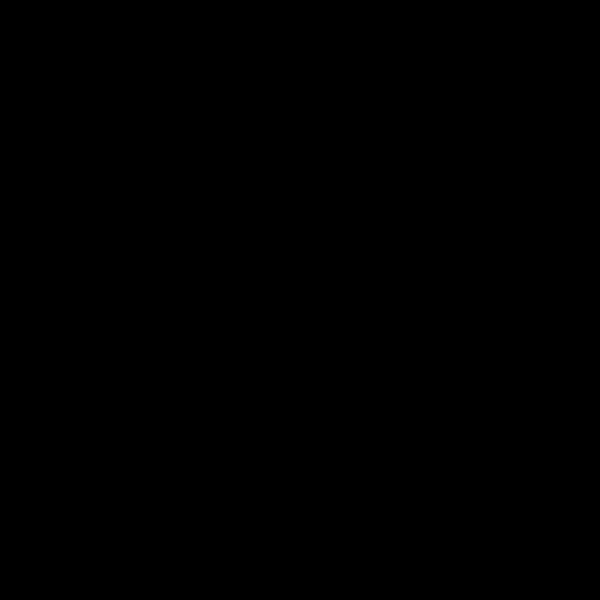

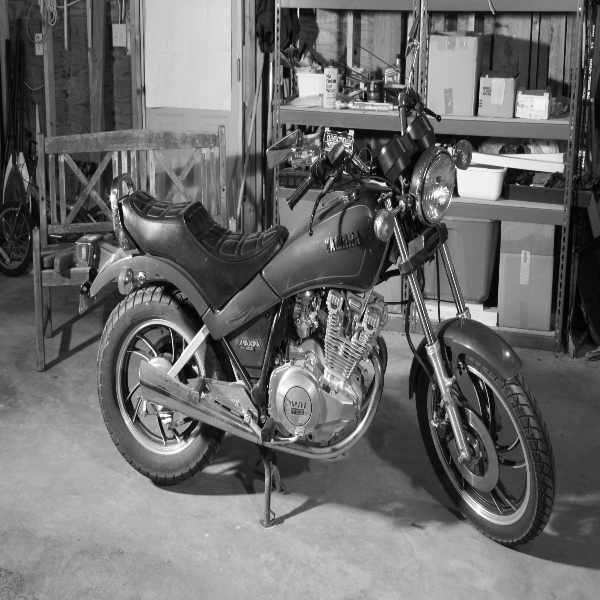

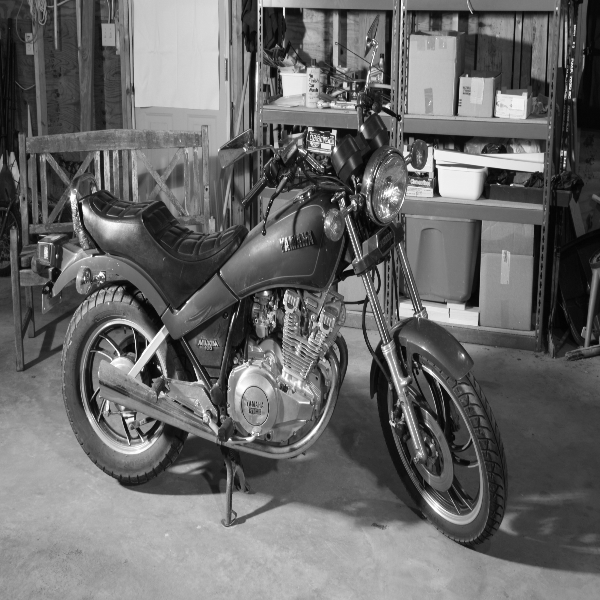

In [ ]:
from __future__ import print_function
from google.colab.patches import cv2_imshow
import numpy as np
import cv2

def main():
    imgL = cv2.imread("/content/im0.png",0)
    imgL = cv2.resize(imgL,(600,600))

    imgR = cv2.imread("/content/im1.png",0)
    imgR = cv2.resize(imgR,(600,600))

    # Setting parameters for StereoSGBM algorithm
    minDisparity = 0
    numDisparities = 64
    blockSize = 8
    disp12MaxDiff = 1
    uniquenessRatio = 10
    speckleWindowSize = 10
    speckleRange = 8

    # Creating an object of StereoSGBM algorithm
    stereo = cv2.StereoSGBM_create(minDisparity = minDisparity,
        numDisparities = numDisparities,
        blockSize = blockSize,
        disp12MaxDiff = disp12MaxDiff,
        uniquenessRatio = uniquenessRatio,
        speckleWindowSize = speckleWindowSize,
        speckleRange = speckleRange
    )

    # Calculating disparith using the StereoSGBM algorithm
    disp = stereo.compute(imgL, imgR).astype(np.float32)

    # Calculating disparith using the StereoSGBM algorithm
    disp = cv2.normalize(disp,0,255,cv2.NORM_MINMAX)

    # Displaying the disparity map
    cv2_imshow(disp)#"disparity",
    cv2_imshow(imgL)#"left image",
    cv2_imshow(imgR)#"right image",
    cv2.waitKey(0)


if __name__ == '__main__':
    main()
    cv2.destroyAllWindows()

# Reference links
- https://github.com/spmallick/learnopencv.git
- https://github.com/kaustubh-sadekar/VirtualCam

# References


[1] J. Weng, P. Cohen, and M. Herniou. Camera calibration with distortion models and accuracy
evaluation. IEEE Transactions on Pattern Analysis and Machine Intelligence, 14(10):965–980,
Oct. 1992.

[2] OpenCV documentation for camera calibration.

[3] C. Loop and Z. Zhang. Computing Rectifying Homographies for Stereo Vision. IEEE Conf. Computer Vision and Pattern Recognition, 1999.